<a href="https://colab.research.google.com/github/aditya248/manhattan-property-sales-EDA/blob/main/A_Team3_Manhattan_property_sale_price_analysis.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# **Assessing sales price of Manhattan properties sold in 2015**

## **Executive Summary**: 

This project focused on analyzing the sale prices of properties sold in Manhattan during 2015.
Our goal is to help people looking to buy properties in Manhattan be it individuals or real estate agents and come up with the most effective way of predicting the sale prices through machine learning. More importantly, we want to generate actionable insights and key indicators aligned with the real estate industry needs.

For this analysis, first we identified the target variable i.e., Sale price. Secondly, we worked on cleaning our data by dropping constant columns and rows that have no significance or Unknown or 0 sale prices. We also did data imputing for numerical columns where data was missing by imputing with median values where needed and Unknown in case of categorical features. Also, we corrected the data types for numerical features from object to float or int wherever needed. We categorized our analysis into categorical and numerical features and provided observations and conclusions for their relationships with our target variable.

Our dataset had zip code and address information but not latitude and longitude information, so we brought that from pgeocode library in python, which we further used in creating a geographic map showing which zip codes have what values for average sale prices.

While doing above analysis, we attempted to use various python visualization libraries like seaborn, matplotlib, bokeh, pgeocode and folium. We also used correlation matrix and Random Forest Regressor to assess which features might be more significant in predicting sale price than others.

After our analysis, we found that the most important factors that affect the property sale price in Manhattan, NY are total units, neighborhood, year built, and land square feet.

Further, we plan did feature engineering and use different machine learning models to predict the sale prices of these properties as accurately as possible and provide our insights to future property buyers and hope it helps the target audience. Out of the 4 ML models we use the least RMSE was given by "XGBoost Regressor". We also made some recommendations that can be taken up for further enhancement of this project and few limitations in this dataset.

## Problem: 
Our goal is to assess and visualize the relationship between sales price of a property in Manhattan and various features in the dataset that might impact it. We will be doing data munging and analysis in python along with visualizations using important python libraries. Examples of questions we will answer and visualize include:
* How the size, location and neighborhood relate to and impact the sales price of a property
* Additional relations will be studied for features like property taxes and year of built and visualize them using different python libraries</br>



## Data and its Source: 
### About the data:
It has 24989 rows X 21 columns.
Each row represents a property in Manhattan, each column contains properties's attributes described as below:
*   **Borough**: The name of the borough  in which the property is located
*   **Neighborhood**: Department of Finance assessors determine the neighborhood name while valuing properties
*   **Building Class Category**: To identify similar properties by broad usage(e.g. One Family  Homes)
*   **Tax Class**: There are four tax classes (Classes 1,2,3 and 4) based on the use of property:

Class1: Includes most residential property of up to three units

Class2: Includes all other property  that is primarily  residential , such as  cooperatives and condominiums

Class3: Includes property with equipment owned by a gas,telephone or electric company 

Class4: Includes all other properties such as offices,factories,garages etc.
*   **Block**: Sub-division of the borough on which real property is located.
*   **Lot**: Sub-division of tax block and represents property's unique location
*   **Address**: Street address of the property
*   **Zip code**: Property's postal code
*   **Residential units**: No. of residential units in a property
*   **Commercial units**: No. of commercial units in a property
*   **Total units**
*   **Land square feet**: Land area of the property listed
*   **Gross square feet**: Total area of all floors of a building,including the land area and the space within the buildings on the property
*   **Year built**: Year the structre on the property was built
*   **Sale price**: Price paid for the property
*   **Sales date**: Date when the propery was sold

### Source:
This dataset is available in open data platform provided by the Housing Development, City of New York</br>
https://data.cityofnewyork.us/Housing-Development/NYC-Calendar-Sales-Archive-/uzf5-f8n2


## Motivation:
Knowing about what all factors are related to property prices and being able to predict the sales price , would help:
1.   People who plan to buy a house so they can know the price range in the future, and then they can plan their finances well
2.   Property price predictions are also beneficial for property investors to know the trend of sales prices in a certain location.
3.   Helps in real estate efficiency


## Team3 Members:
Aditya Sinha,
Chinar Boolchandani,
Qianru Ai,
Niming Wang,
Mochi Zhang

## Data Overview and importing important libraries and packages

In [ ]:
pip install seaborn folium pgeocode sklearn category_encoders -q

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np
import seaborn as sns
from sklearn.pipeline import Pipeline
from sklearn.preprocessing import StandardScaler,PolynomialFeatures
from sklearn.linear_model import LinearRegression
%matplotlib inline
from bokeh.plotting import ColumnDataSource
from bokeh.models import CategoricalColorMapper
from bokeh.io import push_notebook, show, output_notebook
from bokeh.layouts import row 
from bokeh.plotting import figure
import pgeocode
import folium
from folium import plugins
from folium.plugins import MarkerCluster
from category_encoders import OrdinalEncoder
from sklearn.impute import SimpleImputer
from sklearn.ensemble import RandomForestRegressor
from sklearn.pipeline import make_pipeline
import matplotlib.ticker as ticker
from sklearn.linear_model import Lasso
from sklearn.model_selection import GridSearchCV
from sklearn.model_selection import train_test_split
import sklearn.metrics as metrics

output_notebook()

In [ ]:
# from google.colab import drive
 #drive.mount('/content/drive')

In [ ]:
# just for convinience, will delete after complition
df = pd.read_csv("https://raw.githubusercontent.com/aditya248/manhattan-property-sales-EDA/main/Manhattan_properties_2015.csv")
df.head()

,BOROUGH\n,NEIGHBORHOOD\n,BUILDING CLASS CATEGORY\n,TAX CLASS AT PRESENT\n,BLOCK\n,LOT\n,EASE-MENT\n,BUILDING CLASS AT PRESENT\n,ADDRESS\n,APARTMENT NUMBER\n,ZIP CODE\n,RESIDENTIAL UNITS\n,COMMERCIAL UNITS\n,TOTAL UNITS\n,LAND SQUARE FEET\n,GROSS SQUARE FEET\n,YEAR BUILT\n,TAX CLASS AT TIME OF SALE\n,BUILDING CLASS AT TIME OF SALE\n,SALE PRICE\n,SALE DATE\n
0,1,ALPHABET CITY,01 ONE FAMILY DWELLINGS,1,400,19,,A4,526 EAST 5TH STREET,,10009,1,0,1,"1,883","5,200",1900,1,A4,"$6,500,000",3/18/2015
1,1,ALPHABET CITY,03 THREE FAMILY DWELLINGS,1,376,24,,C0,264 EAST 7TH STREET,,10009,3,0,3,"2,059","3,696",1900,1,C0,"$3,775,000",10/22/2015
2,1,ALPHABET CITY,03 THREE FAMILY DWELLINGS,1,377,66,,C0,243 EAST 7TH STREET,,10009,3,0,3,"2,381","3,084",1899,1,C0,"$2,900,000",6/24/2015
3,1,ALPHABET CITY,04 TAX CLASS 1 CONDOS,1C,399,1101,,R6,238 EAST 4TH STREET,-,10009,1,0,1,0,0,1955,1,R6,"$6,995,000",6/15/2015
4,1,ALPHABET CITY,07 RENTALS - WALKUP APARTMENTS,2B,373,16,,C1,326 EAST 4TH STREET,,10009,10,0,10,"2,204","8,625",1899,2,C1,"$20,000,000",11/17/2015


## Data cleaning and imputing

### Data Cleaning:

1) Cleaning the column names by :


*   Remove /n from column names
*   Making the case consistent across all columns
*   Replacing any empty string with NaN

In [ ]:
df.rename(columns=lambda x: x.lower(), inplace=True)
df.rename(columns=lambda x: x[:-1], inplace=True)

df.head()

,borough,neighborhood,building class category,tax class at present,block,lot,ease-ment,building class at present,address,apartment number,zip code,residential units,commercial units,total units,land square feet,gross square feet,year built,tax class at time of sale,building class at time of sale,sale price,sale date
0,1,ALPHABET CITY,01 ONE FAMILY DWELLINGS,1,400,19,,A4,526 EAST 5TH STREET,,10009,1,0,1,"1,883","5,200",1900,1,A4,"$6,500,000",3/18/2015
1,1,ALPHABET CITY,03 THREE FAMILY DWELLINGS,1,376,24,,C0,264 EAST 7TH STREET,,10009,3,0,3,"2,059","3,696",1900,1,C0,"$3,775,000",10/22/2015
2,1,ALPHABET CITY,03 THREE FAMILY DWELLINGS,1,377,66,,C0,243 EAST 7TH STREET,,10009,3,0,3,"2,381","3,084",1899,1,C0,"$2,900,000",6/24/2015
3,1,ALPHABET CITY,04 TAX CLASS 1 CONDOS,1C,399,1101,,R6,238 EAST 4TH STREET,-,10009,1,0,1,0,0,1955,1,R6,"$6,995,000",6/15/2015
4,1,ALPHABET CITY,07 RENTALS - WALKUP APARTMENTS,2B,373,16,,C1,326 EAST 4TH STREET,,10009,10,0,10,"2,204","8,625",1899,2,C1,"$20,000,000",11/17/2015


In [ ]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 24989 entries, 0 to 24988
Data columns (total 21 columns):
 #   Column                          Non-Null Count  Dtype 
---  ------                          --------------  ----- 
 0   borough                         24989 non-null  int64 
 1   neighborhood                    24989 non-null  object
 2   building class category         24989 non-null  object
 3   tax class at present            24989 non-null  object
 4   block                           24989 non-null  int64 
 5   lot                             24989 non-null  int64 
 6   ease-ment                       24989 non-null  object
 7   building class at present       24989 non-null  object
 8   address                         24989 non-null  object
 9   apartment number                24989 non-null  object
 10  zip code                        24989 non-null  int64 
 11  residential units               24989 non-null  object
 12  commercial units                24989 non-null

In [ ]:
for col in df.columns.values.tolist():
  if(df[col].dtypes == "object"):
    df[col] = df[col].str.strip()

# Replace any empty string with nan
df = df.replace('', np.nan)  

2) Check for NULL values , which will be fixed by imputing:

In [ ]:
# Check for any null values
df.isna().sum()

borough                               0
neighborhood                          0
building class category               0
tax class at present                  3
block                                 0
lot                                   0
ease-ment                         24989
building class at present             3
address                               0
apartment number                  12780
zip code                              0
residential units                     0
commercial units                      0
total units                           0
land square feet                      0
gross square feet                     0
year built                            0
tax class at time of sale             0
building class at time of sale        0
sale price                            0
sale date                             0
dtype: int64

### Data Imputing:

Filling the NaN values in Tax class and Building class with "Unknown"

In [ ]:
df['building class at present'] = df['building class at present'].fillna('Unknown')
df['tax class at present'] = df['tax class at present'].fillna('Unknown')

In [ ]:
df[(df['tax class at present'].isnull()) | (df['building class at present'].isnull())]

,borough,neighborhood,building class category,tax class at present,block,lot,ease-ment,building class at present,address,apartment number,zip code,residential units,commercial units,total units,land square feet,gross square feet,year built,tax class at time of sale,building class at time of sale,sale price,sale date


3) Changing columns to correct datatypes based on their values:

In [ ]:
df["sale date"] = df["sale date"].apply(pd.to_datetime)
df["sale price"] = df["sale price"].replace('[\$,]', '', regex=True).astype(float)
df["total units"] = df["total units"].replace('[\,]', '', regex=True).astype(int)
df["land square feet"] = df["land square feet"].replace('[\,]', '', regex=True).astype(float)
df["gross square feet"] = df["gross square feet"].replace('[\,]', '', regex=True).astype(float)
df["residential units"] = df["residential units"].replace('[\,]', '', regex=True).astype(int)
df["tax class at time of sale"] = df["tax class at time of sale"].astype(str)

In [ ]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 24989 entries, 0 to 24988
Data columns (total 21 columns):
 #   Column                          Non-Null Count  Dtype         
---  ------                          --------------  -----         
 0   borough                         24989 non-null  int64         
 1   neighborhood                    24989 non-null  object        
 2   building class category         24989 non-null  object        
 3   tax class at present            24989 non-null  object        
 4   block                           24989 non-null  int64         
 5   lot                             24989 non-null  int64         
 6   ease-ment                       0 non-null      float64       
 7   building class at present       24989 non-null  object        
 8   address                         24989 non-null  object        
 9   apartment number                12209 non-null  object        
 10  zip code                        24989 non-null  int64         
 11  re

4) Dropping columns/rows with:
1.  Constat values, with Standard deviation 0
2.  2 rows that have "Unknown" neighborhoods
3.  5k rows have $0 sale price as they were transfer properties given from a parent to a child and not sold
4.  Apartment number which is very unique to each unit on property and we are not using in our analysis
4. Unknown Tax class is being excluded for our visualizations are analysis

In [ ]:
df = df.drop(['ease-ment'], 1)
df = df.drop(['borough'], 1)
dCol = ['apartment number']
df.drop(dCol, axis=1, inplace=True)
i = df[(df['neighborhood'] == 'MANHATTAN-UNKNOWN') ].index
df.drop(i,inplace=True)
df = df[df['sale price'] > 0]
df = df[df['zip code'] > 0]
j = df[(df['tax class at present'] == 'Unknown') ].index
df.drop(j,inplace=True)

In [ ]:
print(df.nunique())

neighborhood                         38
building class category              42
tax class at present                  8
block                              1385
lot                                1767
building class at present           118
address                           11246
zip code                             46
residential units                   102
commercial units                     50
total units                         114
land square feet                    857
gross square feet                  1169
year built                          137
tax class at time of sale             3
building class at time of sale      120
sale price                         6451
sale date                           298
dtype: int64


### Getting the latitude and longitude(not in our dataset) based on different zipcodes in the dataset:

In [ ]:
zip_code_list = list(df['zip code'])
zip_code_list = [str(x) for x in zip_code_list]

nomi = pgeocode.Nominatim('us')
zip_code_info = nomi.query_postal_code(zip_code_list)
zip_code_info = zip_code_info[["latitude", "longitude" ]]

In [ ]:
df["latitude"] = np.array(zip_code_info["latitude"])
df["longitude"] = np.array(zip_code_info["longitude"])

## **Exploratory Data Analysis**
Understanding how different features in the dataset impact sales price of any property in Manhattan area


### Target Variable : **Property Sale Price**
We are trying to predict the sales price of a property in Manhattan based on various demographic and other features in the dataset

**Observation:**

We can see around 3.5k properties in Manhattan were sold between $100k - $200k and only 1k properties were sold for around $800k - $1million.

/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


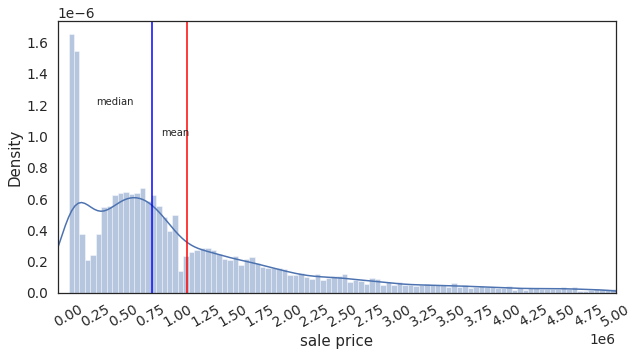

In [ ]:
sns.set_style("white")
plt.figure(figsize=(10,5))
plotd = sns.distplot(df[(df['sale price']>100) & (df['sale price'] < 5000000)]['sale price'], kde=True, bins=100)

tick_spacing=250000 # set spacing for each tick
plotd.xaxis.set_major_locator(ticker.MultipleLocator(tick_spacing))
plotd.set_xlim([-100000, 5000000]) # do not show negative values 
plt.xticks(rotation=30) # rotate x ticks by 30 degrees
plt.axvline(df[(df['sale price']>100) & (df['sale price'] < 5000000)]['sale price'].mean(), c='red')
plt.axvline(df[(df['sale price']>100) & (df['sale price'] < 5000000)]['sale price'].median(), c='blue')
plt.text(250000,0.0000012, "median")
plt.text(850000,0.0000010, "mean")
plt.show();

**Observation:**

Most of the sale prices of properties sold in 2015 in Manhattan are below 1 million dollar , with mean sale price around that. There are few properties that are highly priced which might correspond to "Hotels" , "Office spaces" etc. which lie to the right end of mean sale price.The $0 sale price properties are the ones transfered from parent to child and sold.

### Categorical Variables:
This dataset has 6 categorical variables,out of them we analyzed the ones below:



1.   Neighborhood  
2.   Building class at present and at the time of sale
3.   Tax Class at present and at the time of sale

1. **Neighborhood:**

Questions:

1.   Distribution of number of properties in various neighborhoods of Manhattan
2.   Which neighborhoods have the highest mean property sale prices
3.   Which neighborhood has largest properties
4.   Which neighborhood has high number of residential and commercial units

In [ ]:
#Total unique neighborhoods in dataset
df['neighborhood'].nunique()

38

Categorizing the neighborhoods based on their vicinity on Manhattan's geo map ( initial dataset had 38 neighborhoods, categorized them into 15 nieghborhoods):

In [ ]:
df.neighborhood.replace(['UPPER EAST SIDE (59-79)', 'UPPER EAST SIDE (79-96)','UPPER EAST SIDE (96-110)'], 'UPPER EAST SIDE', inplace=True)
df.neighborhood.replace(['UPPER WEST SIDE (59-79)', 'UPPER WEST SIDE (79-96)','UPPER WEST SIDE (96-116)'], 'UPPER WEST SIDE', inplace=True)
df.neighborhood.replace(['HARLEM-WEST', 'HARLEM-EAST','HARLEM-CENTRAL','WASHINGTON HEIGHTS UPPER','WASHINGTON HEIGHTS LOWER','INWOOD','MORNINGSIDE HEIGHTS'], 'HARLEM/WASHINGTON HEIGHTS', inplace=True)
df.neighborhood.replace(['MIDTOWN WEST', 'MIDTOWN EAST','MIDTOWN CBD','CLINTON','JAVITS CENTER'], 'MIDTOWN', inplace=True)
df.neighborhood.replace(['CHELSEA', 'FLATIRON'], 'CHELSEA', inplace=True)
df.neighborhood.replace(['GREENWICH VILLAGE-CENTRAL', 'GREENWICH VILLAGE-WEST'], 'WEST VILLAGE', inplace=True)
df.neighborhood.replace(['SOHO', 'LITTLE ITALY'], 'SOHO-LITTLE ITALY', inplace=True)
df.neighborhood.replace(['ALPHABET CITY', 'GRAMERCY','EAST VILLAGE','KIPS BAY'], 'EAST VILLAGE', inplace=True)
df.neighborhood.replace(['CHINATOWN', 'CIVIC CENTER','FASHION','SOUTHBRIDGE'], 'CHINATOWN', inplace=True)


In [ ]:
#Total unique neighborhoods after categorizing:
df['neighborhood'].nunique()

15

1. Properties in each neighborhood of Manhattan:

In [ ]:
df['neighborhood'].value_counts().to_frame().head()

,neighborhood
MIDTOWN,5540
UPPER EAST SIDE,3464
UPPER WEST SIDE,2664
HARLEM/WASHINGTON HEIGHTS,1605
CHELSEA,1127


Visualizing the distribution of neighborhood in Manhattan properties dataset:

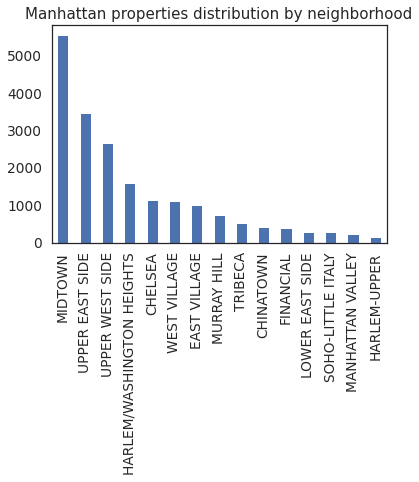

In [ ]:
df['neighborhood'].value_counts().plot.bar()
plt.title("Manhattan properties distribution by neighborhood");

**Observation:**

Midtown has the most properties sold in Manhattan in 2015: more than 5k, followed by Upper East side: around 3k, while Harlem-Upper has the lowest properties sold with just about 200 properties sold in 2015.

2. Wealthiest neighbourhoods in Manhattan with property sales prices being the highest:

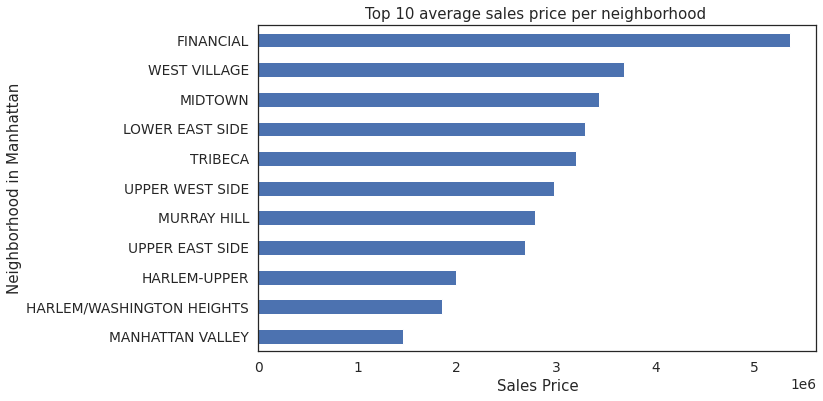

In [ ]:
plt.figure(figsize=(10,6))
df['sale price'].groupby(df['neighborhood']).mean().sort_values()[:11].plot.barh()
plt.title('Top 10 average sales price per neighborhood ')
plt.xlabel("Sales Price")
plt.ylabel("Neighborhood in Manhattan");

**Observation:**

We can see "Financial" neighborhood has the highest average sales price of approximately 5 million for properties sold in 2015,followed by "West Village". These are amongst the wealthiest neighborhoods in Manhattan. Higher property prices could be both due to their proximity to NY City and also due to more commercial properties in such neighborhoods, which tend to be more expensive than residential ones.

3. Which neighborhood has largest mean land sqaure and gross sq ft for the properties sold in 2015 in Manhattan:

Using **pivot table** to analyze how area impacts the sale prices of properties:

In [ ]:
df.pivot_table(values=['land square feet','gross square feet'], index='neighborhood', aggfunc='mean').sort_values(by=['land square feet',
'gross square feet'],axis=0,ascending=False)

,gross square feet,land square feet
neighborhood,,
EAST VILLAGE,16862.346653,4712.148851
LOWER EAST SIDE,4638.473868,1987.773519
SOHO-LITTLE ITALY,14815.202899,1443.547101
HARLEM-UPPER,3517.942675,1251.923567
HARLEM/WASHINGTON HEIGHTS,3594.261059,1129.919003
MIDTOWN,14468.032491,1080.260289
CHINATOWN,5360.710843,745.067470
CHELSEA,3042.518190,576.104703
FINANCIAL,10226.914141,556.098485


**Observation:**

Based on the above pivot table analysis we can see "East Village" has properties sold with highest land and gross sqaure feet of approx 16k sqaure feet and "Tribeca" has the smallest of approx 1300 square feet , amongst the propertis sold in 2015 in Manhattan. As per the data East Village has more Hotel properties and that explains the high square feet areas for this neighborhood's properties. On the other hand Tribeca has mostly residential loft spaces which explains the lowest square feet properties.

Visualization of sale price with area:

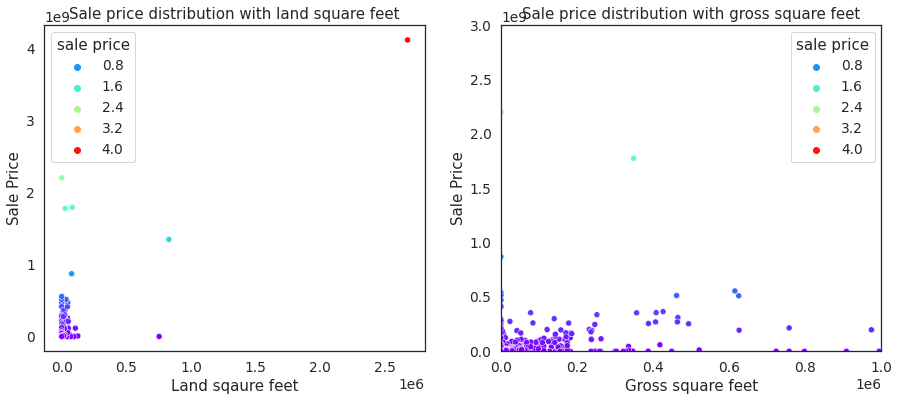

In [ ]:
plt.figure(figsize=(15,6))
plt.subplot(1, 2, 1)
plt.title('Sale price distribution with land square feet')
sns.scatterplot(x="land square feet",y="sale price",hue='sale price',data=df, palette='rainbow')
plt.ylabel('Sale Price')
plt.xlabel('Land sqaure feet')

plt.subplot(1, 2, 2)
plt.title('Sale price distribution with gross square feet')
sns.scatterplot(x="gross square feet",y="sale price",hue='sale price',data=df, palette='rainbow')
plt.ylabel('Sale Price')
plt.xlabel('Gross square feet');
plt.xlim(0,1000000)
plt.ylim(0,3000000000);

**Observation:**

For most properties the sale prices are higher as the square feet increases but this relationship is more stronger with gross square feet(outside area) than with land square feet. There are a few outliers that we might need to re-consider while modelling.

Visualizing the top5 neighborhoods in terms of largest sq feet area:

In [ ]:
df['land square feet'].groupby(df['neighborhood']).mean().sort_values(ascending=False)[:5]

neighborhood
EAST VILLAGE                 4712.148851
LOWER EAST SIDE              1987.773519
SOHO-LITTLE ITALY            1443.547101
HARLEM-UPPER                 1251.923567
HARLEM/WASHINGTON HEIGHTS    1129.919003
Name: land square feet, dtype: float64

In [ ]:
top5_neighborhoods_area=['EAST VILLAGE','LOWER EAST SIDE','SOHO-LITTLE ITALY','HARLEM-UPPER','HARLEM/WASHINGTON HEIGHTS']
df2=df[df['neighborhood'].isin(top5_neighborhoods_area)]

Using Bokeh to visualize the area and sale price relationship in different neighborhoods:

In [ ]:
# Convert df to a ColumnDataSource: source
source = ColumnDataSource(df2)
# Make a CategoricalColorMapper object: color_mapper
color_mapper = CategoricalColorMapper(factors=top5_neighborhoods_area,
                                      palette=['red', 'green', 'blue','orange','yellow'])
# Add a circle glyph to the figure p
p = figure(x_axis_label='gross square feet', y_axis_label='land square feet',x_range=(1000, 17000),y_range=(1000,10000))
p.circle('land square feet', 'gross square feet', source=source,
            color=dict(field='neighborhood',transform=color_mapper),
            legend_field='neighborhood',size=10)
show(p)


**Observation:**

East Village neighborhood has the highest mean sq feet area, amongst the properties sold, while most of the other neighborhoods lie with 4000-6000 sq ft.

4. Which neighborhood has highest residential and which has highest commercial units in their properties?

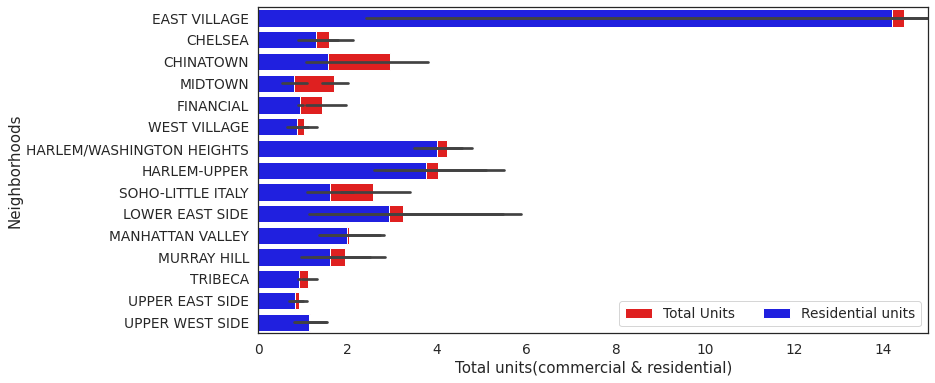

In [ ]:
f, ax = plt.subplots(figsize=(12, 6))
s1 = sns.barplot(x = 'total units', y = 'neighborhood', data = df, color = 'red',label='Total Units')

s2 = sns.barplot(x = 'residential units', y = 'neighborhood', data = df, color = 'blue',label="Residential units")
ax.legend(ncol=2, loc="lower right", frameon=True)
ax.set(xlim=(0, 15), ylabel="Neighborhoods",
       xlabel="Total units(commercial & residential)");

**Observation:**

From above barplot we can see "East Village" has the highest total units with most units being residential. "Chinatown" seems to have most commercial units amongst other neighborhoods". This is as expected since according to our data, "East Village" has mostly hotels and high rise properites with more residential units. "Chinatown" is more like a market area and expected to have more commercial units. Its interesting to see how the type of properties, their square feet areas tie up with the sale prices. 

**2. Building Class**

Questions:
1.   Distribution of properties sold in Manhattan w.r.t building class category
2.   Properties belonging to which building class were sold for the highest price in Manhattan in 2015

1. Distribution of building class category in properties sold in 2015:

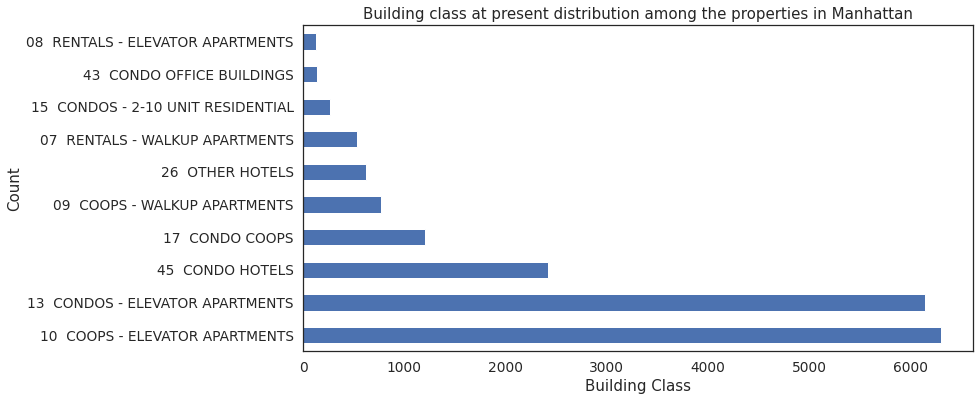

In [ ]:
plt.figure(figsize=(12,6))
df['building class category'].value_counts().head(10).plot.barh()
plt.title("Building class at present distribution among the properties in Manhattan")
plt.ylabel("Count")
plt.xlabel("Building Class");

**Observation:**

"Coops-Elevator Apartments" and "Condos" , are the building classes with most properties sold in Manhattan in 2015. This trend is expected in current times, where most individuals or real estate companies buy "Condominium spaces" and not that much of individual spaces.

2. Properties corresponding to which building class were sold for highest average sale price:

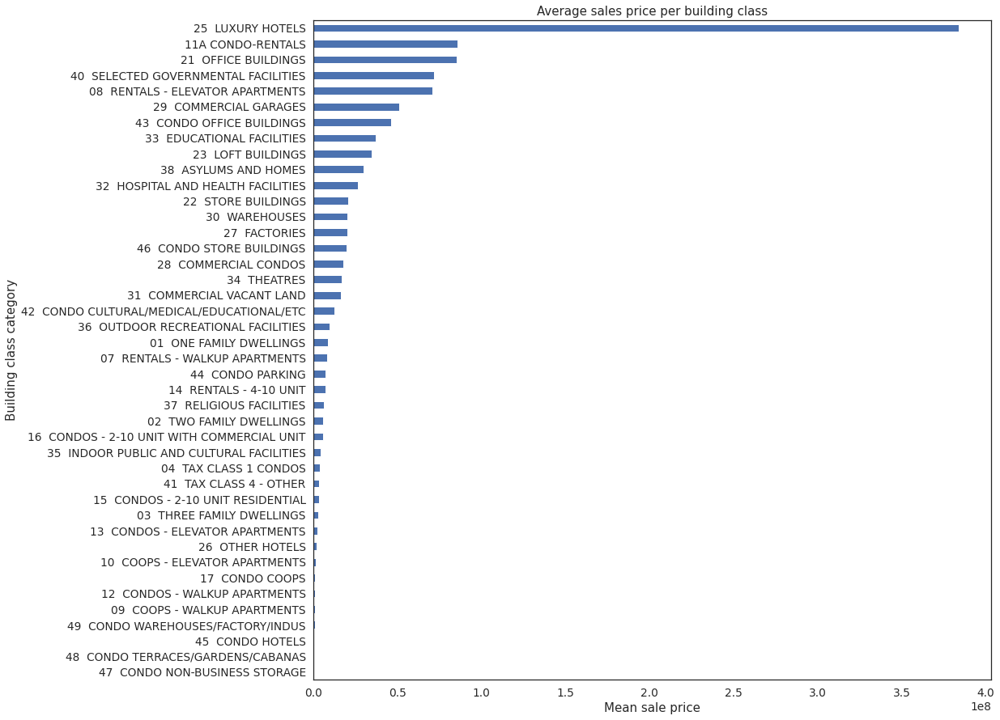

In [ ]:
plt.figure(figsize=(15,15))
df['sale price'].groupby(df['building class category']).mean().sort_values().plot.barh()
plt.ylabel("Building class category")
plt.xlabel("Mean sale price")
plt.title('Average sales price per building class');

**Observation:**
Above plot shows that "Luxury Hotels", "Condo Buildings" and "Offices" are the building classes with highest average sales prices in 2015. Hotels , Condos and Offices are usually high priced because of their square feet sizes and proximity to city or the facilities they provide, this is as expected.

**3. Tax Class**

Questions:
1. Distribution of Tax class among properties in Manhattan
2. Does tax class impact the sale price of a property
3. How many properties had a change in Tax class from sale date to present

In [ ]:
df['tax class at present'].value_counts()

2     14630
4      3737
2C      593
1       248
2B      197
2A      105
1C       11
1A        2
Name: tax class at present, dtype: int64

Distribution of tax class.

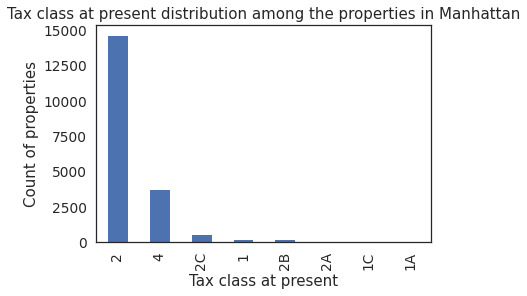

In [ ]:
df['tax class at present'].value_counts().plot.bar()
plt.title("Tax class at present distribution among the properties in Manhattan")
plt.xlabel("Tax class at present")
plt.ylabel("Count of properties");

**Observation:**

The most prevalent Tax class amongst the properties sold in 2015 in Manhattan is Tax class "2" which belongs to properties that are mostly residential such as Condominiums and cooperatives.

In [ ]:
# extract columns
tax_neighborhood = df[['neighborhood','tax class at present']]
tax_neighborhood.head()

,neighborhood,tax class at present
0,EAST VILLAGE,1
1,EAST VILLAGE,1
2,EAST VILLAGE,1
3,EAST VILLAGE,1C
4,EAST VILLAGE,2B


1. Distribution of Tax class in neighborhood

<Figure size 1440x1440 with 0 Axes>

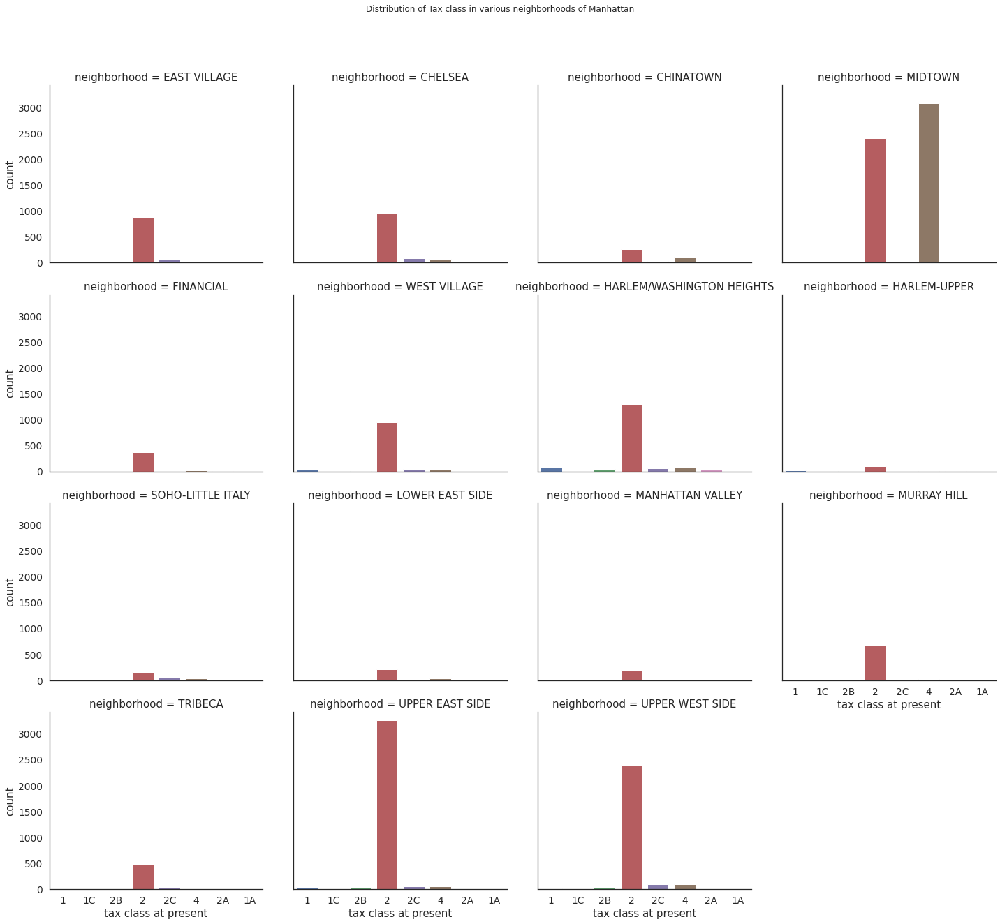

In [ ]:
plt.figure(figsize=(20,20))
sns.catplot(x='tax class at present',data=tax_neighborhood,kind='count',col='neighborhood',col_wrap = 4)
plt.ylabel("Count of properties sold in 2015")
plt.suptitle("Distribution of Tax class in various neighborhoods of Manhattan")
plt.subplots_adjust(top=0.9,bottom=0.1);

**Observation:**</br>
For most neighborhoods, most of the properties sold have tax class "2" at present, followed by tax class "4".</br>
Tax class 2 represents:Mostly residential properties</br>
Tax class 4 represents: Properties like Offices, warehouses,garages etc., non-residential.
Also these tax classes exist at present when the data was collected and not during the time of sale (2015). Department of finance keeps changing the categorization of Tax class or creating new Tax classes, which we will see in below analysis.

2. Sales distribution of different Tax class

In [ ]:
tax_sales = df[['tax class at present','sale price']]
#tax_sales = tax_sales.rename(columns={'tax class at present':'tax_class'})
tax_sales.head()

,tax class at present,sale price
0,1,6500000.0
1,1,3775000.0
2,1,2900000.0
3,1C,6995000.0
4,2B,20000000.0


In [ ]:
tax_sales = tax_sales.groupby('tax class at present').agg({'sale price':'mean'})
# delete index
tax_sales = tax_sales.rename(columns={'sale price':'sale price mean'})
tax_sales.reset_index(inplace=True)
tax_sales.head()

,tax class at present,sale price mean
0,1,6.244542e+06
1,1A,3.500050e+05
2,1C,4.648645e+06
3,2,2.536341e+06
4,2A,6.638357e+06


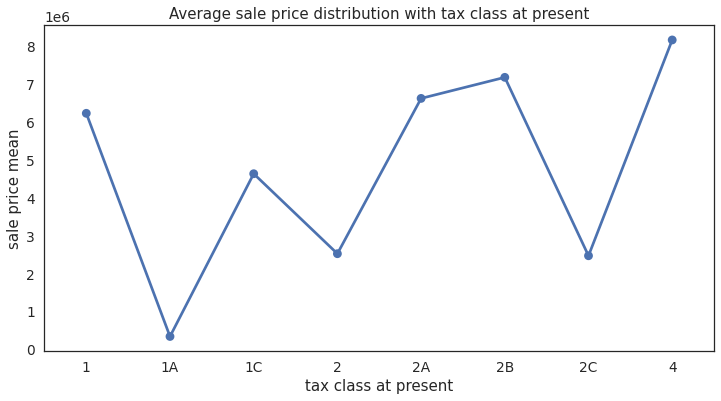

In [ ]:
# Plot
plt.figure(figsize=(12,6))
sns.pointplot(x='tax class at present',y='sale price mean',data=tax_sales)
plt.title("Average sale price distribution with tax class at present");

**Observation:**

The highest mean sale price belongs to Tax class '4', followed by '2B'.

Tax class 4 represents: Properties like Offices, warehouses,garages etc., non-residential.
Tax class 2B represents : Properties that are mostly residential and condominiums.
This can be explained by the fact that Offices,warehouses etc. are huge spaces and generally in locations where real estate prices are at boom, so this Tax class "4" corresponds to properties that were sold at highest sale prices on average.

3. Analyzing the change in Tax class at present vs. at time of sale and how the change in Tax class is associated with change in sales price:

Distribution of Tax class at the time of sale amongst all the properties in Manhattan:

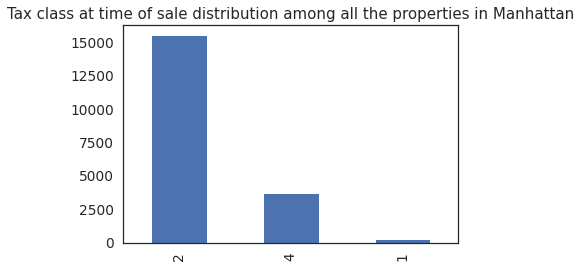

In [ ]:
df['tax class at time of sale'].value_counts().plot.bar()
plt.title("Tax class at time of sale distribution among all the properties in Manhattan");

In [ ]:
tax_tax = df[['tax class at present','tax class at time of sale']]
tax_tax = tax_tax.dropna()
tax_tax.head()

,tax class at present,tax class at time of sale
0,1,1
1,1,1
2,1,1
3,1C,1
4,2B,2


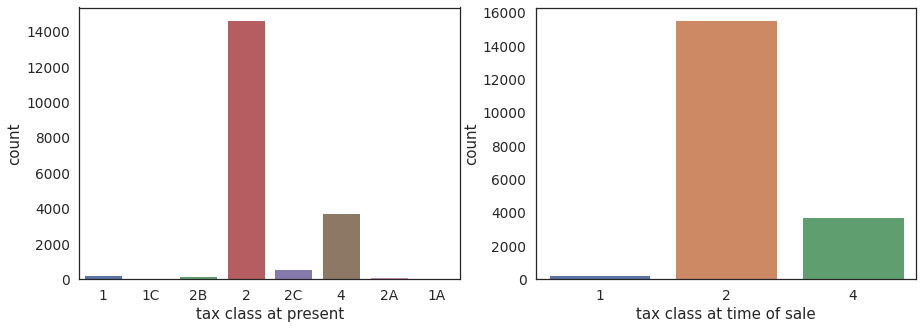

In [ ]:
# two other options --> Liked this one better
fig, ax_arr = plt.subplots(1,2,figsize=(15,5))
sns.countplot(x='tax class at present', data=tax_tax,ax = ax_arr[0])
sns.countplot(x='tax class at time of sale',data=tax_tax,ax = ax_arr[1]);

**Observation:**</br>
We can see there are many new sub Tax classes that are present now like 2B,2C, 2A etc. which were not present during the time of sale of those properties. Also the most common Tax class has remained to be Tax class "2" followed by Tax class "4".
Reclassification of Tax Classes happen when there is a change in the use of a property, for example from Office to residential.

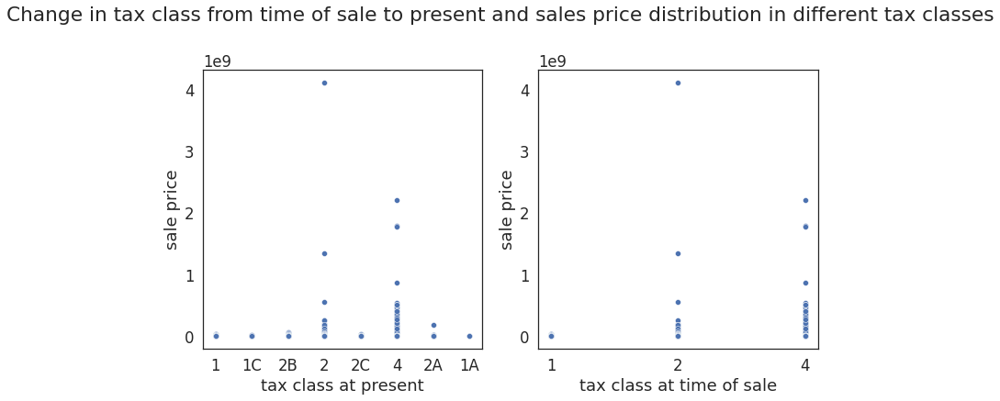

In [ ]:
fig = plt.figure(figsize=(12, 12))
sns.set(font_scale=1.5,style='white')
fig1 = fig.add_subplot(221); 
sns.scatterplot(x = df['tax class at present'], y = df['sale price'],palette= 'YlOrRd')
fig2 = fig.add_subplot(222); 
sns.scatterplot(x = df['tax class at time of sale'], y = df['sale price'], palette= 'YlOrRd')
plt.suptitle("Change in tax class from time of sale to present and sales price distribution in different tax classes")
plt.subplots_adjust(top=0.9);

**Observation:**</br>
Most of the tax classes at present were not there at the time of sale, we see at the time of sale only Tax classes , 1,2 and 4. Also for both tax class at present and tax class at time of sale, tax class "2" has the highest sale price.

### Numerical Variables:
This dataset has 7 numerical variables, each of them is analyzed below:
1.   Zip code  
2.   Land square feet and gross square feet
3.   Residential and commercial units
4.   Year of built
5.   Sale date



**1. Zip code**:

Map analysis to find out the zip code with the highest average sale price in Manhattan.


In [ ]:
# Neighboorhood and zip code
neighborhood_zip = df[['zip code','neighborhood']]
neighborhood_zip.drop_duplicates('zip code', inplace=True)

df_zip =  df.groupby(["zip code"]).agg({'sale price':"mean", 'latitude':'mean', "longitude" : 'mean'})
df_zip = df_zip.reset_index()

df_zip = pd.merge(df_zip, neighborhood_zip, how='left', on='zip code')
df_zip['ZIP'] = df_zip['zip code'].astype(str)

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  This is separate from the ipykernel package so we can avoid doing imports until


In [ ]:
print(df_zip.head())

   zip code    sale price  latitude  longitude  neighborhood    ZIP
0     10001  8.861737e+06   40.7484   -73.9967       CHELSEA  10001
1     10002  3.511681e+06   40.7152   -73.9877  EAST VILLAGE  10002
2     10003  2.655826e+06   40.7313   -73.9892  EAST VILLAGE  10003
3     10004  2.222425e+06   40.7143   -74.0060     FINANCIAL  10004
4     10005  1.049661e+07   40.7056   -74.0083     FINANCIAL  10005


In [ ]:
map = folium.Map([40.7831,-73.9712],zoom_start=12, tiles='stamentoner')
map.choropleth(geo_data="https://raw.githubusercontent.com/aditya248/manhattan-property-sales-EDA/main/manhattan-zip-code-tabulation-areas-polygons.geojson",
             data=df_zip,
             columns=['ZIP', 'sale price'],
             key_on='feature.properties.postalCode',
             fill_color='YlGnBu', fill_opacity=0.8, line_opacity=.5,
             legend_name='SALE PRICE')

marker_cluster = MarkerCluster().add_to(map) # create marker clusters

for i,row in df_zip.iterrows():
     location = [row['latitude'],row['longitude']]
     tooltip = "Zipcode:{}<br> Neighborhood: {} <br> Click for more".format(row["ZIP"], row["neighborhood"])
     folium.Marker(location, 
                  popup="""<i>Mean sales price: </i> <br> <b>${}</b> <br>""".format(round(row['sale price'],2)),
                   tooltip=tooltip).add_to(marker_cluster)
 
map

/usr/local/lib/python3.7/dist-packages/folium/folium.py:426: FutureWarning: The choropleth  method has been deprecated. Instead use the new Choropleth class, which has the same arguments. See the example notebook 'GeoJSON_and_choropleth' for how to do this.
  FutureWarning


**Observation:**
Zipcode 10005 in Financial neighborhood has the highest mean sales price in Manhattan. This aligns with our observation of highest mean sale prices with respect to neighborhoods and since Financial lies in close proximity to NY city , is mostly comprised of commercial buildings and properties are in high demand leading to higher sale prices.

**2. Land square feet and Gross square feet:**

In [ ]:
df.pivot_table(values=['sale price'], index='land square feet', aggfunc='mean').sort_values(by=['land square feet'],axis=0,ascending=False).head(5)

,sale price
land square feet,
2675000.0,4.111112e+09
828650.0,1.345485e+09
753175.0,1.000000e+00
124560.0,7.070000e+06
105050.0,1.150000e+08


**Observation:**

We can see from above pivot table that more the Land square feet more is the sale price. Land square feet is the the land area of the property listed in square feet. There is a positive coorelation of land square feet and sale prices.

We can see that land square feet and sales price are positively correlated.


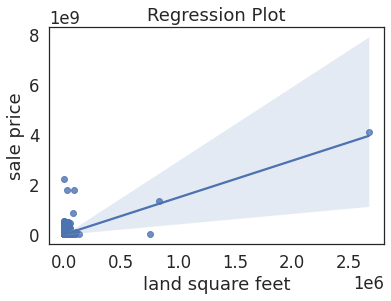

In [ ]:
sns.regplot(x=df['land square feet'], y=df['sale price'])
plt.title("Regression Plot")
print("We can see that land square feet and sales price are positively correlated.")

In [ ]:
p = figure(title = "Distribution of sale price with land and gross square feet",x_range=(1000,300000),
y_range=(10000, 400000000),x_axis_label="Sq ft",y_axis_label="Sale price in $")
p.circle('land square feet','sale price',source=df,fill_alpha=0.1, size=10,color='blue',legend_label='land square feet')
p.circle('gross square feet','sale price',source=df,fill_alpha=0.1, size=10,color='red',legend_label='gross square feet')
p.legend.location = "bottom_right"
show(p)


**Observation:**</br>
Gross square feet refers to the total area of all floors in the building including space within any structre of property. So gross square feet values are higher than land square feet values and sale prices have a linear positive relationship wiht both land and gross square feet as seen above.

We can see that gross square feet and sales price are positively correlated.


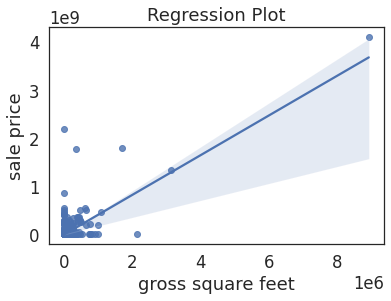

In [ ]:
sns.regplot(x=df['gross square feet'], y=df['sale price'])
plt.title("Regression Plot")
print("We can see that gross square feet and sales price are positively correlated.")

**3. Residential and commercial units**

Questions:

1.   What is the number of residential and commercial units with highest sale prices?
2.   What is the total number of units with highest sale prices?
3.   Which neighborhoods have higher residential and which have higher commercial units?



In [ ]:
#removing outliers for better visualization
df = df.drop(df[(df['residential units']<1) & (df['residential units']>9000) & (df['sale price']>1000000000)].index)
df = df.drop(df[(df['commercial units']<1) & (df['commercial units']>9000) & (df['sale price']>1000000000)].index)
df = df.drop(df[(df['total units']<1) & (df['total units']>9000) & (df['sale price']>1000000000)].index)

from bokeh.layouts import row
from bokeh.layouts import column
p1 = figure(title = "Distribution of sale price with residential units",x_range=(0,300),
y_range=(10000, 180000000),x_axis_label="residential units",y_axis_label="Sale price in $")
p2 = figure(title = "Distribution of sale price with commercial units",x_range=(0,300),
y_range=(10000, 180000000),x_axis_label="commercial units",y_axis_label="Sale price in $")
p3 = figure(title = "Distribution of sale price with total units",x_range=(0,300),
y_range=(10000, 180000000),x_axis_label="total units",y_axis_label="Sale price in $")
p1.circle('residential units','sale price',source=df,fill_alpha=0.1, size=10,color='blue')
p2.circle('commercial units','sale price',source=df,fill_alpha=0.1, size=10,color='red')
p3.circle('total units','sale price',source=df,fill_alpha=0.1, size=10,color='green')
row2 = row([p1, p2])#, sizing_mode='scale_width')
# Make a column layout that includes the above row layout: layout
layout = column([row2, p3])
#layout =row(p1,p2,p3)
show(layout);


**Observation:**
For most properties as the number of residential or commercial units or total units is increasing the sales price is more, with the exceptions of few properties like "Luxury Hotels","Stores","offices", "Hospitals" etc. which have 0 total units but are highly priced. Total units are sum of residential and commercial units on any property. In case of hotels and public areas this is higher since they either have high number of residential or high number of commercial units in them.

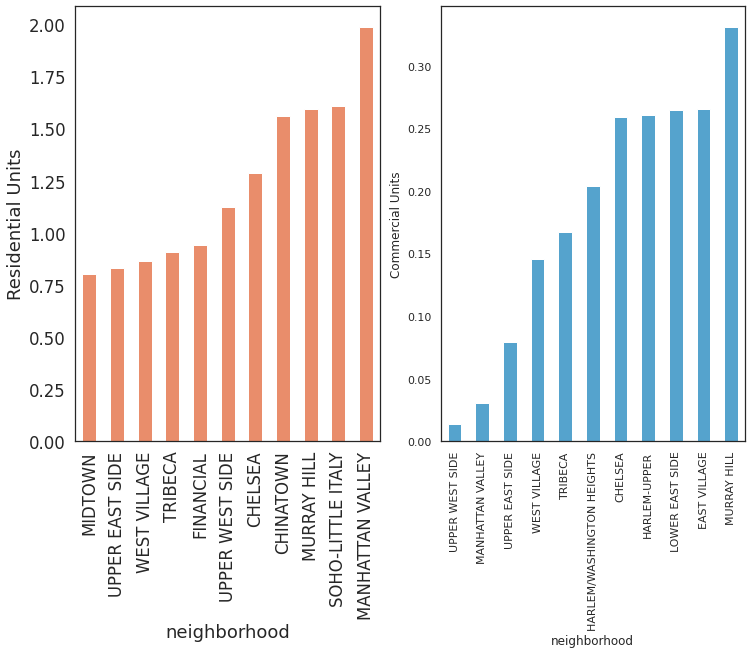

In [ ]:
plt.figure(figsize=(12,8))
plt.subplot(1, 2, 1)
sns.set(palette="flare",style='white')

df['residential units'].groupby(df['neighborhood']).mean().sort_values()[:11].plot.bar()
#sns.barplot(x="neighborhood", y="residential units", data=df, estimator=sum, ci=None)
plt.ylabel('Residential Units')

plt.subplot(1, 2, 2)
sns.set(palette="icefire",style='white')
df['commercial units'].groupby(df['neighborhood']).mean().sort_values()[:11].plot.bar()
plt.ylabel('Commercial Units');

**Observation:**

We can see Mahattan Valley has the highest residential units whereas Murray Hill has highest commercial units. This aligns with the facts that Manhattan Valley mostly has high rise buildings with homes whereas Murray hills has many business places and cafes for the young crows that lives there.

**4. Year of property built**

Questions:
1.   Which year were most of the properties that are being sold built in Manhattan?
2.   Does the year of build impact sales price of that property?
3.   Is the size of any property related to the year of built, like in 90s  bigger properties were built but with population increasing over the years property sizes decreased ?

1. Year-wise distribution of properties sold in Manhattan 2015:

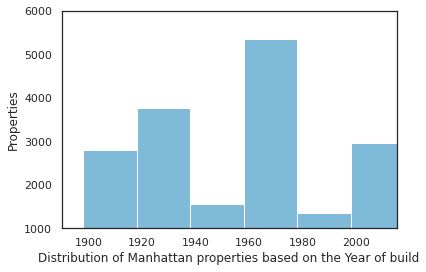

In [ ]:
sns.histplot(df[df['year built']!=0]['year built'],bins=20,binwidth=20);
plt.ylabel("Properties")
plt.xlabel("Distribution of Manhattan properties based on the Year of build")
plt.ylim(1000,6000)
plt.xlim(1890,2015);

**Observation:**

Most properties sold in 2015 in Manhattan were built between 1960-1980 (35-55 year old properties being sold). Very less properties built in 1980-2000 were sold in 2015. This could also be understood as that most people dont sell properties earlier than 30-40 years of being built since the property valuation fluctuates with the economy and takes time to increase in valuation enought to be profitable to sell. There can be other factors to this trend as well. Also properties older than 60-70 years were not sold much may be becuase the property depreciation was more than renovation costs.

2. How does the year of build impact sales price of that property:

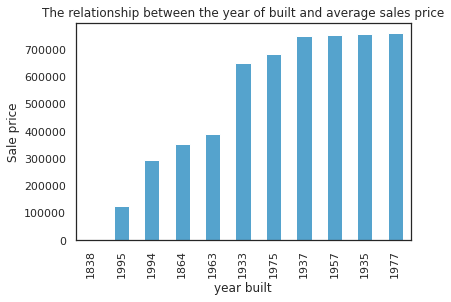

In [ ]:
df['sale price'].groupby(df['year built']).mean().sort_values()[:11].plot.bar()
plt.ylabel('Sale price');
plt.title('The relationship between the year of built and average sales price');

**Observation:**

The properties built in 1933/1975/1937/1957/1935/1977 have a higher sale price than others. This gives a ballpark to someone planning to sell property as to within how many years of built is a property good to be sold and has more chances of being sold.

3.Is the size of any property related to the year of built, like in 90s  bigger properties were built but with population increasing over the years property sizes decreased ?

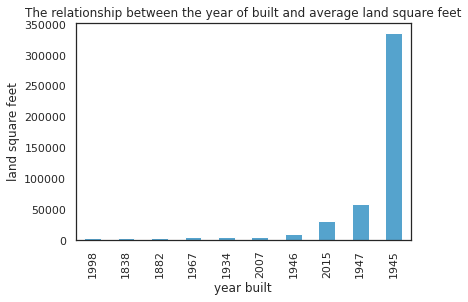

In [ ]:
df['land square feet'].groupby(df['year built']).mean().sort_values()[-10:].plot.bar()
plt.ylabel('land square feet');
plt.title('The relationship between the year of built and average land square feet');


**Observation:**

Houses built in 1945 have the maximum average sq ft areas and the years later to it or even before have smaller square feet areas. This could lead to interesting insights as to why 1945 had this surge in sizes.

**5. Sale date**

Question:
1.   Which month in 2015 had the highest sale prices? This could show the real estate prices going up, could be related to economic or social changes and help people decide when to buy or sell a property:

In [ ]:
#Extracting Month from sale date and creating a new column in df
df['month of sale'] = df['sale date'].dt.strftime('%b')
df.sort_values(by='sale date',inplace=True)

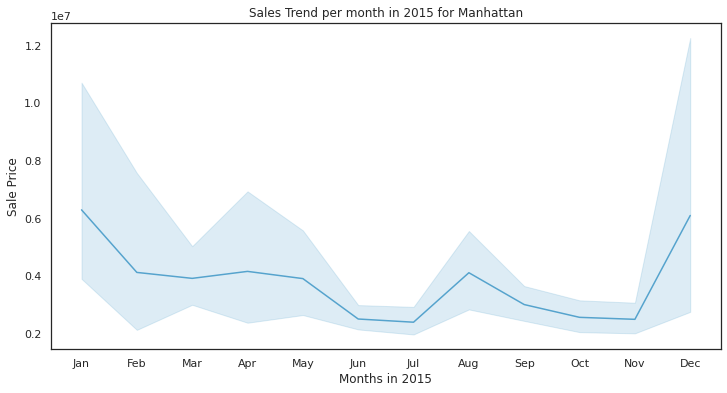

In [ ]:
plt.figure(figsize=(12,6))
sns.lineplot(x='month of sale',y='sale price',data=df,sort=True)
plt.title('Sales Trend per month in 2015 for Manhattan')
plt.ylabel('Sale Price')
plt.xlabel('Months in 2015')
plt.show();

**Observation:**

Above lineplot shows highest sale prices were from Dec-Feb 2015 and decreased thereafter, with slight increase during Aug-Sep2015.
This could lead to interesting insights as to why the property prices were higher during winter months compared to summer months, it could be attributed to holidays or economic trends during 2015 that governed the real estate prices.

2. Sale trend by month for top 5 neighborhoods with highest sale prices:

In [ ]:
df['sale price'].groupby(df['neighborhood']).mean().sort_values(ascending=False)[:5]

neighborhood
EAST VILLAGE         8.333317e+06
SOHO-LITTLE ITALY    8.315967e+06
CHINATOWN            7.959927e+06
CHELSEA              7.259080e+06
FINANCIAL            5.357640e+06
Name: sale price, dtype: float64

In [ ]:
top5_neighborhoods=['EAST VILLAGE','SOHO-LITTLE ITALY','CHINATOWN','CHELSEA','FINANCIAL']
df1= df[df['neighborhood'].isin(top5_neighborhoods)]

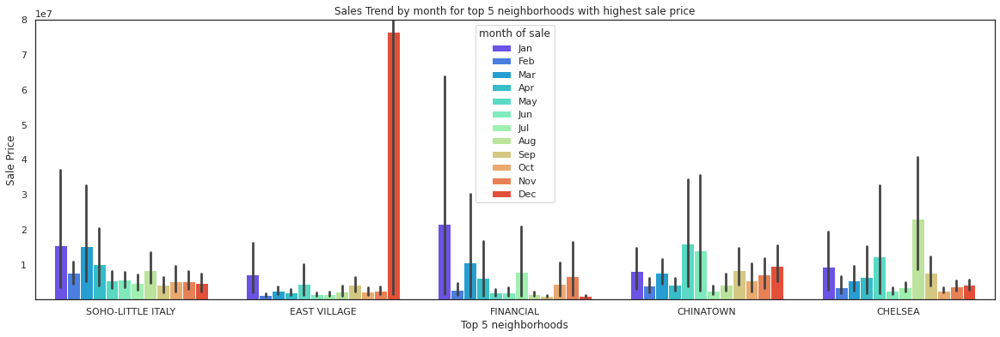

In [ ]:
plt.figure(figsize=(20,6))
sns.barplot(x='neighborhood', y='sale price', hue='month of sale', data=df1, palette='rainbow');
plt.title('Sales Trend by month for top 5 neighborhoods with highest sale price')
plt.ylabel('Sale Price')
plt.xlabel('Top 5 neighborhoods')
plt.ylim(50000,80000000)
plt.show();

**Observation:**

Above plot shows that January,July and August are the months where Sale prices are the highest for top neighborhoods in Manhattan during 2015 with the outlier being for Decemeber for East Village.
East Village remains the most wealthiest neighborhood in our dataset of Manhattan properties sold in 2015.

Correlation between different features:

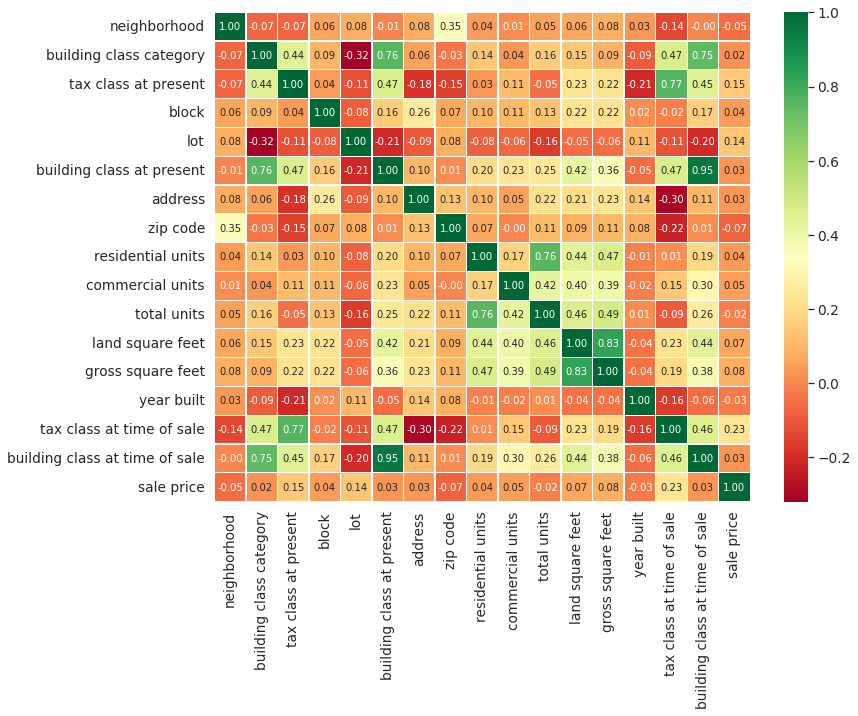

In [ ]:
plt.figure(figsize=(12, 9))
sns.set(font_scale=1.25)
#heatmap_df = df.drop(['month of sale', 'latitude', 'longitude', 'sale date'], axis=1)
corr = heatmap_df.apply(lambda x: pd.factorize(x)[0]).corr()
ax = sns.heatmap(corr, xticklabels=corr.columns, yticklabels=corr.columns, annot=True,fmt='.2f',annot_kws={'size': 10},
                 linewidths=.2, cmap="RdYlGn")


In [ ]:
cor=df.corr()
cor_target = abs(cor["sale price"])
cor_target

block                0.017766
lot                  0.004733
zip code             0.012329
residential units    0.719302
commercial units     0.260455
total units          0.725773
land square feet     0.716988
gross square feet    0.741235
year built           0.017211
sale price           1.000000
latitude             0.026857
longitude            0.017496
Name: sale price, dtype: float64

**Observations:**

The features that show high positive correlation with sale price are : 
1.   Number of residential,commercial and total units
2.   Land square and gross square feet
4.   zipcode and block
5.   year built

The features with less positive correlation are:
1.   Lot 
2.   Address
3.   Building class category

## **Conclusions about the important variables and relationships from our EDA:**

To get some preliminary feature importances we will use the Random Forest Regressor, a wellknown decision-tree based model. We have made a pipeline with


1.   OrdinalEncoder - To transfrom categorical variables 
2.   SimpleImputer - To impute any missing values
3.   RandomForestRegressor - To get feature importance

We try to set hyperparamters using Prof. Mohammad‌ ‌Soltanieh-ha‌ model.

Dropped categorical columns with high cardinality.

In [ ]:
drop_cols = [ 'address', 'latitude', 'longitude', 'sale date','month of sale']
df_removed_cardnaility = df.drop(drop_cols, 1)

# Convert zip code to categorical variable.
df_removed_cardnaility['zip code'] = df_removed_cardnaility['zip code'].astype(str)

In [ ]:
df_removed_cardnaility.info()

# Target and feature columns
drop = ["sale price"]
x, y = df_removed_cardnaility.drop(drop,axis=1), df_removed_cardnaility["sale price"]

<class 'pandas.core.frame.DataFrame'>
Int64Index: 19523 entries, 4078 to 6222
Data columns (total 16 columns):
 #   Column                          Non-Null Count  Dtype  
---  ------                          --------------  -----  
 0   neighborhood                    19523 non-null  object 
 1   building class category         19523 non-null  object 
 2   tax class at present            19523 non-null  object 
 3   block                           19523 non-null  int64  
 4   lot                             19523 non-null  int64  
 5   building class at present       19523 non-null  object 
 6   zip code                        19523 non-null  object 
 7   residential units               19523 non-null  int64  
 8   commercial units                19523 non-null  int64  
 9   total units                     19523 non-null  int64  
 10  land square feet                19523 non-null  float64
 11  gross square feet               19523 non-null  float64
 12  year built                    

In [ ]:
pipe_ord = make_pipeline(
    OrdinalEncoder(), 
    SimpleImputer(), 
    RandomForestRegressor(
        n_estimators=100, random_state=0, max_depth=14, oob_score=True, 
        n_jobs=4, min_samples_split=5, max_features=8)
)

In [ ]:
pipe_ord.fit(x, y)

Pipeline(memory=None,
         steps=[('ordinalencoder',
                 OrdinalEncoder(cols=['neighborhood', 'building class category',
                                      'tax class at present',
                                      'building class at present', 'zip code',
                                      'tax class at time of sale',
                                      'building class at time of sale'],
                                drop_invariant=False, handle_missing='value',
                                handle_unknown='value',
                                mapping=[{'col': 'neighborhood',
                                          'data_type': dtype('O'),
                                          'mapping': WEST VI...
                 RandomForestRegressor(bootstrap=True, ccp_alpha=0.0,
                                       criterion='mse', max_depth=14,
                                       max_features=8, max_leaf_nodes=None,
                                   

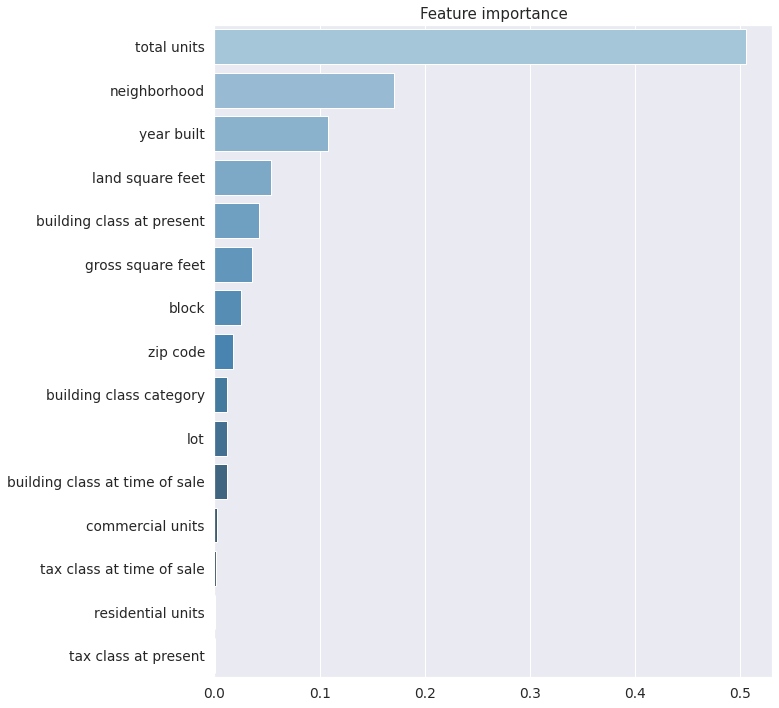

In [ ]:
importance = pipe_ord[2][1].feature_importances_
imp = pd.Series(data=importance, index=x.columns).sort_values(ascending=False)
plt.figure(figsize=(10,12))
plt.title("Feature importance")
ax = sns.barplot(y=imp.index, x=imp.values, palette="Blues_d", orient='h')

The importances are in line with our previous analysis. Below 4 are the the top 4 features that seem to play important role in predicting sale price:


1.   Total Units
2.   Neighborhood
3.   Year built
4.   Land square feet

**Conclusions from our EDA:**</br>
1.   In our dataset the median sale prices of Properties sold in Manhattan in 2015 , lies around 0.75 million dollar and mean sale price lies around 1 million dollar.
2.   Analysis of various categorical and numerica features from the dataset show interesintg trends in data which can be used to predic sale prices on unseen data:</br>

Neighborhood : "Midtown" neighborhood has the most number of properties sold in 2015. "Financial" neighborhood seems to be the most wealthiest of all in our dataset, with highest average sale prices going up to $ 5 million. Also "East Village" neighborhood seems to have the biggest properties being sold in 2015 compared to other neighborhoods.

Tax Class: Tax class represents the classification by Department of finance based on the usage of a property. From our EDA we can conclude that during the time of sale only Tax classes 1,2,4 existed but at present when the data was collected by Housing Department of NY , more reclassifications of Tax class were done based on change in their usuage. New Categories such as 2A,2B and 2C were amongst the few that were created. Tax class showed relationship with sale price, with highest average sale prices belonging to properties under Tax class 4(commerical usage) followed by 2(residential usage).

Building Class : Categorization based on property's constructive use.
Example, "A" denotes single homes, "R" condominiums and so on. With respect to sale price we observed that properties belonging to "Cooperatives" and "Elevator Apartments" have the highest average sale prices.

Land and Gross Square feet : These have positive correlation with sale prices and for most properties lie within the range of 1k-300k square feet.

Zip Code : In our dataset we have the zipcodes for each property sold in 2015 in Manhattan and based on these zipcodes when we analyzed the sale prices, we were able to categorize and represent then on a map. This showed zipcode for East Village : 10009 had the highest average sale price.

Total units: The number of residential and/or commercial units in a property also showed positive correlation with sale price. Manhattan Valley neighborhood had the most residential units and Murray Hill had the most commercial units, with total units being highest for East Village.

Year Built : We can conclude that properties built atleast 35-40 years old are more likely to be sold than the ones built later or earlier to that. Also the sale prices seem highest for properites built in 1933/1975/1937/1957/1935/1977 years. We also concluded that bigger square feet houses were mostly built in year 1945.

Month of sale: From the sale date , we extracted the month column to see how different months impact sale prices, and observed for most neighborhoods, highest sale prices were during the months Jan-April and August with some outliers of Dec month in case of East Village neighborhood.

Our top most important features from RandomForestClassifier are, which we will be using in our modelling :
1.   Total Units
2.   Neighborhood
3.   Year built
4.   Land square feet

# Applying Machine Learning to predict property sale prices:

list for storing all ML model results:

In [ ]:
results = []

## **Lasso(Least Absolute Shrinkage and Selection Operator) Regression with GridSearchCV**:

#### 1) Feature Engineering:

##### Removing year built column and calculating age of house:

In [ ]:
df['year sold'] = 2015

In [ ]:
df['age of house'] = df['year sold'] - df['year built']

In [ ]:
df['age of house'].head()

4078     115
15867    115
15868    115
14991     95
14990     95
Name: age of house, dtype: int64

##### Removing land square feet and gross square feet columns and calculating total area as new column:

In [ ]:
df['area']=df['gross square feet']+df['land square feet']

##### One hot encoding for categorical features:

In [ ]:
df_dummies = pd.get_dummies(df,columns=['neighborhood','building class at present'],drop_first=True)

Dropping features that we created like latitude,longitude and ones that are least important like zip code, sale date etc:

In [ ]:
df_dummies=df_dummies.drop(['year sold','year built','building class at time of sale','building class category','lot','block','zip code','address','latitude','longitude','sale date','month of sale','tax class at present','tax class at time of sale','residential units','commercial units'],1)

In [ ]:
df_dummies.head()

,total units,land square feet,gross square feet,sale price,age of house,area,neighborhood_CHINATOWN,neighborhood_EAST VILLAGE,neighborhood_FINANCIAL,neighborhood_HARLEM-UPPER,neighborhood_HARLEM/WASHINGTON HEIGHTS,neighborhood_LOWER EAST SIDE,neighborhood_MANHATTAN VALLEY,neighborhood_MIDTOWN,neighborhood_MURRAY HILL,neighborhood_SOHO-LITTLE ITALY,neighborhood_TRIBECA,neighborhood_UPPER EAST SIDE,neighborhood_UPPER WEST SIDE,neighborhood_WEST VILLAGE,building class at present_A5,building class at present_A7,building class at present_A9,building class at present_B1,building class at present_B2,building class at present_B3,building class at present_B9,building class at present_C0,building class at present_C1,building class at present_C2,building class at present_C3,building class at present_C4,building class at present_C5,building class at present_C6,building class at present_C7,building class at present_C8,building class at present_C9,building class at present_D0,building class at present_D1,building class at present_D2,...,building class at present_P5,building class at present_P7,building class at present_P9,building class at present_Q1,building class at present_R1,building class at present_R2,building class at present_R3,building class at present_R4,building class at present_R5,building class at present_R6,building class at present_R7,building class at present_R8,building class at present_R9,building class at present_RA,building class at present_RB,building class at present_RG,building class at present_RH,building class at present_RK,building class at present_RP,building class at present_RR,building class at present_RS,building class at present_RT,building class at present_RW,building class at present_S0,building class at present_S1,building class at present_S2,building class at present_S3,building class at present_S4,building class at present_S5,building class at present_S9,building class at present_V1,building class at present_V9,building class at present_W1,building class at present_W5,building class at present_W6,building class at present_W7,building class at present_W8,building class at present_W9,building class at present_Z2,building class at present_Z9
4078,60,9001.0,37999.0,5343594.0,115,47000.0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
15867,30,4908.0,20195.0,2381000.0,115,25103.0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
15868,30,4908.0,20195.0,730500.0,115,25103.0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
14991,30,4451.0,17124.0,730500.0,95,21575.0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
14990,30,4451.0,17124.0,550000.0,95,21575.0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0


#### 2) Modelling:

In [ ]:
X = df_dummies.drop('sale price', axis=1)
X.shape

(19523, 136)

Creating target vector:

In [ ]:
y = df_dummies['sale price']
y.shape

(19523,)

Train test split of data

In [ ]:
# Splitting data into train and test set with 70:30 ratio
Xtrain, Xtest, ytrain, ytest = train_test_split(X, y, test_size=0.3, random_state=780)

Fitting lasso with grid search CV:

In [ ]:
params = {'alpha': [0.000001,0.00001,0.0001,0.001, 0.01, 1.0,2]}
l_num =7
lasso = Lasso()
# Cross validation with 5 folds
model_cv = GridSearchCV(estimator=lasso,
                       param_grid=params,n_jobs = 100,
                       scoring='r2',
                       cv=10,
                       return_train_score=True,verbose=False)
# Fitting the model with train set
model_cv.fit(Xtrain, ytrain);

/usr/local/lib/python3.7/dist-packages/sklearn/linear_model/_coordinate_descent.py:476: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 5.304467642640731e+18, tolerance: 3464908500570745.0
  positive)


Optimal value of Lambda from CV:

In [ ]:
best_alpha = model_cv.best_params_.get('alpha')
best_alpha

2

Implementing Lasso with optimal Lambda:

In [ ]:
type(Xtrain)

pandas.core.frame.DataFrame

In [ ]:
# Instantiate Lasso regression with alpha=2
model_lasso = Lasso(best_alpha)
# Fitting the model with the train set
model_lasso.fit(Xtrain, ytrain)

/usr/local/lib/python3.7/dist-packages/sklearn/linear_model/_coordinate_descent.py:476: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 5.304467642640731e+18, tolerance: 3464908500570745.0
  positive)


Lasso(alpha=2, copy_X=True, fit_intercept=True, max_iter=1000, normalize=False,
      positive=False, precompute=False, random_state=None, selection='cyclic',
      tol=0.0001, warm_start=False)

In [ ]:
import sklearn.metrics as metrics
y_pred = model_lasso.predict(Xtest)
root_mean_squared_error= metrics.mean_squared_error(ytest, y_pred,squared=False)
mean_squared_error= metrics.mean_squared_error(ytest, y_pred,squared=True)
print("RMSE for Lasso with Gridearch CV is :",root_mean_squared_error)


RMSE for Lasso with Gridearch CV is : 19300607.408737134


In [ ]:
results.append(["Lasso with Gridearch CV", mean_squared_error, root_mean_squared_error])

## **Random Forest**

In [ ]:
X_random_forest = df_removed_cardnaility.drop('sale price', axis=1)
y_random_forest = df_removed_cardnaility['sale price']

In [ ]:
# Train-test split
Xtrain_rf, Xtest_rf, ytrain_rf, ytest_rf = train_test_split(X_random_forest, y_random_forest, test_size=0.3, random_state=780)

###### Base Model

In [ ]:
pipe_ord_rf = make_pipeline(
    OrdinalEncoder(), 
    SimpleImputer(), 
    RandomForestRegressor(oob_score=True, n_jobs=4)
)

In [ ]:
model_base_rf = pipe_ord_rf.fit(Xtrain_rf, ytrain_rf)

In [ ]:
y_pred_base_rf = model_base_rf.predict(Xtest_rf)
print(metrics.mean_squared_error(ytest_rf, y_pred_base_rf,squared=False))

14779787.446161252


###### Hyperparameter Tuning

In [ ]:
# Number of trees in random forest
n_estimators = [int(x) for x in np.linspace(start = 20, stop = 200, num = 5)]
# Number of features to consider at every split
max_features = ['auto', 'sqrt']
# Maximum number of levels in tree
max_depth = [int(x) for x in np.linspace(1, 45, num = 3)]
# Minimum number of samples required to split a node
min_samples_split = [5, 10]

# Create the random grid
random_grid = {'n_estimators': n_estimators,
               'max_features': max_features,
               'max_depth': max_depth,
               'min_samples_split': min_samples_split}

# First create the base model to tune
m = RandomForestRegressor()

In [ ]:
from sklearn.model_selection import RandomizedSearchCV

m = RandomForestRegressor()
pipe_ord_rf_rfs = make_pipeline(
    OrdinalEncoder(), 
    SimpleImputer(), 
    RandomizedSearchCV(estimator = m, param_distributions = random_grid, n_iter = 10, cv = 10, verbose=2, random_state=42, n_jobs = -1, scoring='neg_mean_squared_error')
)

In [ ]:
pipe_ord_rf_rfs.fit(Xtrain_rf, ytrain_rf)
rf_best = pipe_ord_rf_rfs[2].best_estimator_ 

Fitting 10 folds for each of 10 candidates, totalling 100 fits


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 2 concurrent workers.
[Parallel(n_jobs=-1)]: Done  37 tasks      | elapsed:   13.7s
[Parallel(n_jobs=-1)]: Done 100 out of 100 | elapsed:  2.0min finished


In [ ]:
pipe_ord_rf = make_pipeline(
    OrdinalEncoder(), 
    SimpleImputer(), 
    rf_best
)

model_rf = pipe_ord_rf.fit(Xtrain_rf, ytrain_rf)

In [ ]:
y_pred_rf_gs = model_rf.predict(Xtest_rf)
mean_squared_error_rf = metrics.mean_squared_error(ytest_rf, y_pred_rf_gs,squared=True)
root_mean_squared_error_rf = metrics.mean_squared_error(ytest_rf, y_pred_rf_gs,squared=False)

In [ ]:
print("RMSE of Random Forest: ", root_mean_squared_error_rf)

RMSE of Random Forest:  12934218.691480342


In [ ]:
results.append(["Random Forest Regressor", mean_squared_error_rf, root_mean_squared_error_rf])

## Decision Tree:

In [ ]:
# new packages need to import
from sklearn import tree
import graphviz
from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score, confusion_matrix, precision_score, recall_score

In [ ]:
# remove columns with no prediction power
df_tree = df.drop(['building class category','address'],axis=1)
# create dummies
df_tree = pd.get_dummies(df_tree, 'neighborhood', drop_first=True)  # neighborhood is the version with 15 values
df_tree = pd.get_dummies(df_tree, 'tax class at present', drop_first=True)
df_tree = pd.get_dummies(df_tree, 'building class at present', drop_first=True)
df_tree = pd.get_dummies(df_tree, 'tax class at time of sale', drop_first=True)
df_tree = pd.get_dummies(df_tree, 'building class at time of sale', drop_first=True)
# process date
df_tree['sale date'] = pd.to_datetime(df_tree['sale date'],infer_datetime_format=True)
df_tree['sale date']=df_tree['sale date'].apply(lambda x: x.toordinal())

In [ ]:
y_tree = df_dummies['sale price']
X_tree = df_dummies.drop('sale price', axis=1)
X_train_tree, X_test_tree, y_train_tree, y_test_tree = train_test_split(X_tree, y_tree, test_size=0.3,
                     random_state=780)

In [ ]:
tree_model = tree.DecisionTreeClassifier(random_state=780)
tree_fit = tree_model.fit(X_train_tree, y_train_tree)
print(tree_fit.tree_.node_count)

4243


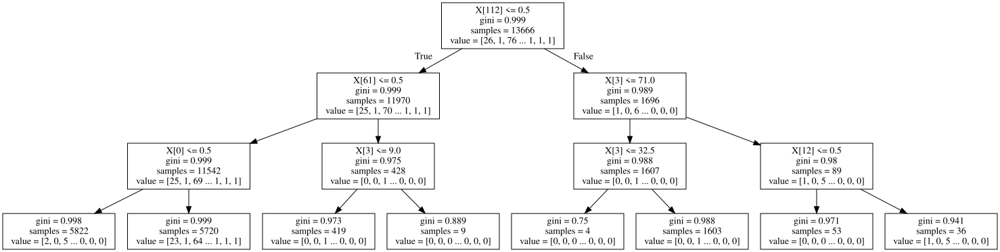

<Figure size 648x648 with 0 Axes>

In [ ]:
# this model is only used for visualization
plt.figure(figsize=(9,9))
import graphviz

tree_structure = tree.export_graphviz(tree.DecisionTreeClassifier(max_depth=3,random_state=780).fit(X_train_tree, y_train_tree), out_file=None)
graph = graphviz.Source(tree_structure)
graph

In [ ]:
# predict
y_model_tree = tree_model.predict(X_test_tree)
# evaluate
result_tree = pd.DataFrame({'prediction':y_model_tree, 'true_value':y_test_tree})
MSE_tree = np.mean((result_tree.true_value -result_tree.prediction) ** 2)
print("MSE of decision tree: ", MSE_tree)

MSE of decision tree:  440898668022872.9


In [ ]:
RMSE_tree =  np.sqrt(np.mean((result_tree.true_value -result_tree.prediction) ** 2) )
print("RMSE of decision tree: ",RMSE_tree)

RMSE of decision tree:  20997587.195267767


In [ ]:
results.append(["Decision tree", MSE_tree, RMSE_tree])

## Extreme Gradient Boosting

In [ ]:
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import OrdinalEncoder

label = df_dummies["sale price"]
#df.drop(columns=["address","sale price","sale date"],inplace=True)
object_column = df_dummies.select_dtypes(include="object")
number_column = df_dummies.select_dtypes(exclude="object")
encoder = OrdinalEncoder()
object_column = encoder.fit_transform(object_column)
data = np.concatenate([number_column.values,object_column],axis=1)
X_train, X_test, y_train, y_test = train_test_split(data, label, test_size=0.3, random_state=780)

In [ ]:
import xgboost
from numpy import loadtxt
from xgboost import XGBRegressor
import xgboost as xgb
from hyperopt import STATUS_OK, Trials, fmin, hp, tpe
from sklearn.metrics import mean_squared_error

In [ ]:
space={'max_depth': hp.quniform("max_depth", 3, 18, 1),
        'gamma': hp.uniform ('gamma', 1,9),
        'reg_alpha' : hp.quniform('reg_alpha', 40,180,1),
        'reg_lambda' : hp.uniform('reg_lambda', 0,1),
        'colsample_bytree' : hp.uniform('colsample_bytree', 0.5,1),
        'min_child_weight' : hp.quniform('min_child_weight', 0, 10, 1),
        'n_estimators': 180,
        'seed': 0}

In [ ]:
def objective(space):
    clf=xgb.XGBRegressor(
                    n_estimators =space['n_estimators'],verbosity = 0, max_depth = int(space['max_depth']), gamma = space['gamma'],
                    reg_alpha = int(space['reg_alpha']),min_child_weight=int(space['min_child_weight']),
                    colsample_bytree=int(space['colsample_bytree']))
    evaluation = [( X_train, y_train), ( X_test, y_test)]
    clf.fit(X_train, y_train,
            eval_set=evaluation, eval_metric="rmse",
            early_stopping_rounds=10,verbose=False)
    pred = clf.predict(X_test)
    rmse = np.sqrt(mean_squared_error(y_test,pred))
    print("The rmse score is:{}".format(rmse))
    print("\n")
    return {'loss': rmse, 'status': STATUS_OK }

In [ ]:
trials = Trials()
best_hyperparams = fmin(fn = objective,
                        space = space,
                        algo = tpe.suggest,
                        max_evals = 100,
                        trials = trials);

The rmse score is:16659908.864211867
The rmse score is:16685217.94612422
The rmse score is:16576963.166519651
The rmse score is:16675338.16915909
The rmse score is:16587656.858775076
The rmse score is:16582567.418635393
The rmse score is:16661085.02604712
The rmse score is:15987157.301204028
The rmse score is:16584680.615842894
The rmse score is:16003203.105837246
The rmse score is:16054987.52938004
The rmse score is:15977356.11034876
The rmse score is:16682770.573393252
The rmse score is:16584780.30868546
The rmse score is:16576963.16947918
The rmse score is:16584780.315146541
The rmse score is:16576963.141566746
The rmse score is:15965641.615784112
The rmse score is:16661110.76826137
The rmse score is:16682562.00838836
The rmse score is:16237138.789778989
The rmse score is:16224579.024486816
The rmse score is:16203753.249320352
The rmse score is:15991052.317162765
The rmse score is:16022573.603304805
The rmse score is:16203753.2311809
The rmse score is:16009578.728364136
The rmse sco

In [ ]:
best_hyperparams

{'colsample_bytree': 0.5466874497890509,
 'gamma': 7.306849519130033,
 'max_depth': 5.0,
 'min_child_weight': 2.0,
 'reg_alpha': 40.0,
 'reg_lambda': 0.4909772378617323}

In [ ]:
model_xg =   clf=xgb.XGBRegressor( verbosity=0,
                    max_depth = 17, 
                    gamma = 4.565168020528752,
                    min_child_weight=2,
                    colsample_bytree=0.5380879073533964,
                    reg_alpha = 116.0,
                    reg_lambda = 0.4172791493882524
                    )

In [ ]:
model_xg.fit(X_train, y_train)
y_model_xg = model_xg.predict(X_test)

In [ ]:
MSE_xg = np.mean((y_test - y_model_xg) ** 2)
print("MSE of decision tree: ", MSE_xg)

MSE of decision tree:  26730526676287.906


In [ ]:
RMSE_xg =  np.sqrt(np.mean((y_test - y_model_xg) ** 2) )
print("RMSE of decision tree: ",RMSE_xg)

RMSE of decision tree:  5170157.3163964655


In [ ]:
results.append(["XGBRegressor", MSE_xg, RMSE_xg])

## Machine learning model conclusion

We will evaluate the model based on their RMSE score. Lower the RMSE score better the model for prediction.

In [ ]:
df_models = pd.DataFrame(results, columns=['Model Name', 'MSE', 'RMSE'])
df_models.sort_values(by='RMSE')

,Model Name,MSE,RMSE
3,XGBRegressor,2.673053e+13,5.170157e+06
1,Random Forest Regressor,1.672940e+14,1.293422e+07
0,Lasso with Gridearch CV,3.725134e+14,1.930061e+07
2,Decision tree,4.408987e+14,2.099759e+07


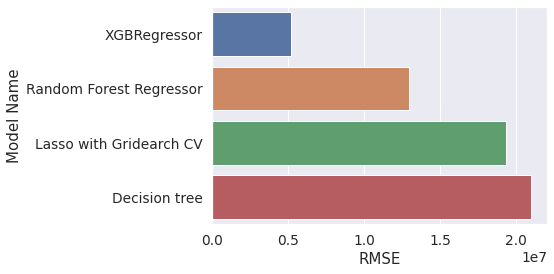

In [ ]:
df_models = df_models.sort_values("RMSE")
sns.barplot(data = df_models, x = "RMSE" , y = 'Model Name')
plt.show()

**Observation:** XGBoost has the lowest RMSE of 5.170157e+06. So we can say, it is the best among the 4 machine learning models we used for predicting sale price. XGBoost works on Gradient Boosting Algorithm, where each subsequent tree works on correcting the residual errors from the previous tree and thus learning from errors made by previous models(trees). This model when given optimal hyperparameter performs the best.

**Overall conclusion and recommendations from our study:**</br>

Conclusions:
We can conclude while predicting property sale prices below factors should be considered:</br>
1.   The neighborhood where property is located
2.   Number of residential and/or commercial units in the property
3.   How old is the property
4.   Square feet area of the property both in terms of land area and common areas included in larger properties
5.   The purpose of usage of any property, if its commercial , residential or hotels etc.

Based on the feature importance we performed feature engineering and created some new columns for important features and dropped some insignificant features. We also created dummy variables for categorical variables to be converted to numerical values of 0 or 1. This helps in linear model training and helps linear models predict better.

Machine Learning: We implemented below models and selected the metrics as MSE/RMSE for evaluating model performance.
1.   Lasso with GridSearchCV : RMSE 1.930061e+07
2.   Random Forest Regressor : RMSE 1.334887e+07
3.   Decision Tree : RMSE 2.099759e+07
4.   Extreme Gradient Boosting : RMSE 5.170157e+06

Out of these models the best performing model for our dataset was Extreme Gradient Boosting regressor with least RMSE of 5.170157e+06 ( this is high number since its in the same units as our target variable: Sale price in USD)
Since XGBoost works on creating multitude of tress overcoming the errors from previous trees and building new ones with the final output being based on the sum of predictions from all small trees in the algorithm , it helps in making best predictions and giving better results than other linear or simple decision tree models. It has many hyperparameters like "learning rate" and max_depth that can be further tuned for best results. 
Also we noticed using feature engineering helped improve the performance. When we created more features by transformation on existing important features RMSE of all 4 models decreased substantially.

Recommendations :</br>
This analysis and XGBoost model can be used to make a recommendation system for any real estate website( using python flask) and help users get a predicted sale price.
Advanced feature engineering can be done to further improve model performance and hyperparameter tuning for XGBoost like tuning optimal number of trees, optimal depth etc. can also improvide the model performance further.

Limitations:</br>
1.   Since this dataset only contains data of properties sold in  2015, these sale price trends can vary for other years and other cities.With more years data merged to this one and doing a time series analysis could lead to more accurate sale price predictions
2.   Manhattan being a very populated city might not be representative of other cities, data from other types of cities combined with this data can give better picture for real estate market in NY area.





**Refrences:**
1.   Datacamp for Bokeh and feature importance
2.   NYC Folium Map : https://medium.com/@saidakbarp/interactive-map-visualization-with-folium-in-python-2e95544d8d9b
3.   https://www.analyticsvidhya.com/blog/2016/03/complete-guide-parameter-tuning-xgboost-with-codes-python/

